# Late Birds solution
## 10th Climate Informatics Hackathon
### Dánnell Quesada and Aris Marcolongo
The original documentation of the challenge, original Jupyter Notebook and test dataset is [here](https://competitions.codalab.org/my/datasets/download/791b6fe7-de61-45ae-8890-05270324da19).


Load all needed modules and letting memory growth in GPU


In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rc
import matplotlib.animation as animation
import tensorflow as tf
physical_devices = tf.config.experimental.list_physical_devices('GPU')
tf.config.experimental.set_memory_growth(physical_devices[0], True)
print(physical_devices)
print(tf.version.VERSION)
from tensorflow.keras import Input, Model
from tensorflow.keras.layers import Conv1D, Conv2D, Conv2DTranspose, MaxPooling2D
from tensorflow.keras.activations import softmax
from tensorflow.keras.preprocessing.image import load_img, img_to_array, array_to_img
from skimage.metrics import structural_similarity as ssim


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
2.3.0


## Functions definition
* `Cleanup_scale` removes the images with less than the stated amount of non-black pixels
* `step_up`, `step_down` and `model_unet` define the UNET architecture's metaparameters and their interconnectedness. Note the possibility of running the model with more than one GPU (comment within `model_unet`)
* `custom_loss` = 1-SSIM (see original documentation)
* `train_plot` just to visualize the training process
* `create_and_run_model` does several things at once
  * Preprocess the datasets
  * Sets the metaparameters
  * Saves the model, check the callbacks details (early stopping)
  * Returns model, history and preprocessed datasets


In [2]:
def Cleanup_scale(Cloud_data, True_data, to_remove=0.5):
    tc1 = np.delete(True_data, np.where(np.count_nonzero(True_data, axis=(1,2,3))/ (127*127*3) < to_remove),0)
    ct1 = np.delete(Cloud_data, np.where(np.count_nonzero(True_data, axis=(1,2,3))/ (127*127*3) < to_remove),0)

    tc2 = np.delete(tc1, np.where(np.sum(ct1, axis=(1,2,3))==0.),0)
    ct2 = np.delete(ct1, np.where(np.sum(ct1, axis=(1,2,3))==0.),0)

    for i in range(tc2.shape[0]):
        ct2[i,:,:,:] = ct2[i,:,:,:]/255
        tc2[i,:,:,:] = tc2[i,:,:,:]/255

    return ct2, tc2

# UNET steps definition by Aris

def step_down ( x , kernel_size, activation, out_curr_channel_dim, return_downsampled = True ):

    """
    Args:
      x : input tensor of dimension ( None, n_rows = 1, n_col, n_channels )
    Returns:
      x_conv : The tensor x convolved, to be used in the skip connections
      x: The tensor x_conv after downsampling via max pooling ( 2 )
    """

    print('step_down')
    x = Conv2D(filters=out_curr_channel_dim, activation=activation, kernel_size=(kernel_size,kernel_size), padding='same')(x)

    print(x)
    # check initialization of kernel, biases

    x_conv = Conv2D(filters=out_curr_channel_dim, activation=activation, kernel_size=(kernel_size,kernel_size), padding='same')(x)
    print(x)

    # do we want to apply a dropout ( after the activation right ? )

    if (return_downsampled):

      x_conv_and_down = MaxPooling2D((2,2), strides=(2,2), padding='same')(x_conv)
      return x_conv, x_conv_and_down

    else:

      return x_conv

def step_up ( x , down_to_conc ,  kernel_size, activation, current_channel_dim, remove_one_pixel_before_concat=False ):

    """
    Args:
      x : input tensor of dimension ( None, n_rows = 1, n_col, n_channels )

      down_to_conc : input tensor to concatenate to x, saved from down path
    Returns:
      x: The tensor x after upsampling, concatenating with y and two convolutions
    """

    #upsampling
    x = Conv2DTranspose(filters=current_channel_dim/2, kernel_size=(2,2),strides=(2,2))(x)

    #crop and concatenate with down-path
    if (remove_one_pixel_before_concat):
      x = x[:,:-1,:-1,:]

    x = tf.concat([down_to_conc, x], axis=-1)

    #conv that halves the number of channels again
    x = Conv2D(filters=current_channel_dim/2, activation=activation, kernel_size=(kernel_size,kernel_size), padding='same')(x)

    #conv keeping the same number of channels
    x = Conv2D(filters=current_channel_dim/2, activation=activation, kernel_size=(kernel_size,kernel_size), padding='same')(x)

    return x

# Custom loss function
def custom_loss(img1,img2):
    custom_loss = 1- tf.image.ssim(img1, img2, max_val=1)
    return custom_loss

def model_unet(n_layers, channel_seed, kernel_size, input_dim):

    channels  =[ channel_seed  *(2**i) for i in range(n_layers)]
    print(channels)

    # TODISCUSS:  127 is a strange input dimension...
    # pad images ?

    inputs = Input(shape=(input_dim,input_dim,3), name="inputs")

    x=inputs

    print(x)

    layers_path_down={}

    #down-path
    for i_layer in range(n_layers-1):
        layers_path_down[i_layer], x = step_down( x, kernel_size=kernel_size, activation='relu', out_curr_channel_dim=channels[i_layer], return_downsampled=True)

    #down the hill we do not need to save the layer (return_downsampled=False)
    x = step_down( x, kernel_size=kernel_size, activation='relu', out_curr_channel_dim=channels[-1], return_downsampled=False )


    #up the hill
    for i_layer in range(n_layers-1,0,-1):
        print('up:', i_layer)
        if (i_layer!=1):
            x = step_up ( x ,  layers_path_down[i_layer-1],  kernel_size=kernel_size, activation='relu', current_channel_dim=channels[i_layer] )
        else:
            x = step_up ( x ,  layers_path_down[i_layer-1],  kernel_size=kernel_size, activation='relu',
                         remove_one_pixel_before_concat=True, current_channel_dim=channels[i_layer] )


    #final convolution to reduce the number of channels

    x =  Conv2D(filters=3, activation='sigmoid', kernel_size=(1,1))(x)

    outputs = x

    model=Model(inputs, outputs, name='model_'+str(n_layers)+'_'+str(channel_seed))

    # Uncomment the following for more PAWA and change amount of gpus accordingly
    # model = tf.keras.utils.multi_gpu_model(model, gpus=2)

    optimizer = tf.keras.optimizers.Adam(0.001)

    model.compile(loss=custom_loss, optimizer = optimizer, metrics=['mse'])

    return model

def train_plot(history):
    plt.figure(dpi= 128, figsize=(8,4))
    mse = history.history['mse']
    val_mse = history.history['val_mse']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(mse) + 1)
    plt.subplot(1,2,1)
    plt.plot(epochs, mse, 'bo', label='Training mse')
    plt.plot(epochs, val_mse, 'r', label='Validation mse')
    plt.title('Training and validation mse')
    plt.legend()
    plt.subplot(1,2,2)
    plt.plot(epochs, loss, 'bo', label='Training loss')
    plt.plot(epochs, val_loss, 'r', label='Validation loss')
    plt.title('Training and validation loss')
    plt.legend()
    plt.show()

def create_and_run_model(epochs=100, batch_size=32, to_remove=0.5, n_layers=3, channel_seed=128, kernel_size=3, validation_split=0.2, run=1):
    CloudTopNZ, TrueColorNZ = Cleanup_scale(CloudTop, TrueColor, to_remove=to_remove)
    model=model_unet(n_layers=n_layers, channel_seed=channel_seed, kernel_size=kernel_size, input_dim=127)
    model.summary()
    print('mdl_L-{}_Ch-{}_k-{}_B-{}_R-{:0.3f}_V-{:0.2f}_r{}.hdf5'.format(n_layers, channel_seed, kernel_size, batch_size, to_remove, validation_split, run))
    earlyStopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=7)
    mcp_save = tf.keras.callbacks.ModelCheckpoint('mdl_L-{}_Ch-{}_k-{}_B-{}_R-{:0.3f}_V-{:0.2f}_r{}.hdf5'.format(n_layers, channel_seed, kernel_size, batch_size, to_remove, validation_split, run), save_best_only=True, monitor='val_loss')
    #reduce_lr_loss = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, verbose=1, min_delta=1e-4, mode='min')

    history = model.fit(CloudTopNZ, TrueColorNZ, epochs=epochs, batch_size=batch_size, validation_split=validation_split, callbacks=[earlyStopping, mcp_save]) #, reduce_lr_loss

    # Uncomment for automatically seeing plots after training
    #train_plot(history)

    return model, history, CloudTopNZ, TrueColorNZ


## Load data
* X_train can be found [here](https://drive.google.com/file/d/1-BFovmVOU9Cp5i_iyaAMYt6TuF_LLwmC/view)
* And Y_train [here](https://drive.google.com/file/d/1-B4PHcZrtZSzwOAtGGTXY3ljy8apt4Zs/view)


In [3]:
CloudTop = np.load("X_train_CI20.npy")
TrueColor = np.load("Y_train_CI20.npy")
TrueColor.shape, CloudTop.shape


((8423, 127, 127, 3), (8423, 127, 127, 3))

## Train the model
1. Model is trained, the metaparameters are the ones related to the model that is obtaining a 0.85 score on _Codalab_.
2. Plot training process.
3. To have an idea of our performance, which was closer to the score of _Codalab_ with the validation dataset during the Hackathon, a very *_naive_* calculation of the score is done, which is also used to later name the predictions and animations (`naive_score`).


In [5]:
model, hist, CT, TC = create_and_run_model(epochs=100, batch_size=16, to_remove=0.975, n_layers=6, channel_seed=32, kernel_size=3, validation_split=0.1, run=4)

[32, 64, 128, 256, 512, 1024]
Tensor("inputs_1:0", shape=(None, 127, 127, 3), dtype=float32)
step_down
Tensor("conv2d_23/Relu:0", shape=(None, 127, 127, 32), dtype=float32)
Tensor("conv2d_23/Relu:0", shape=(None, 127, 127, 32), dtype=float32)
step_down
Tensor("conv2d_25/Relu:0", shape=(None, 64, 64, 64), dtype=float32)
Tensor("conv2d_25/Relu:0", shape=(None, 64, 64, 64), dtype=float32)
step_down
Tensor("conv2d_27/Relu:0", shape=(None, 32, 32, 128), dtype=float32)
Tensor("conv2d_27/Relu:0", shape=(None, 32, 32, 128), dtype=float32)
step_down
Tensor("conv2d_29/Relu:0", shape=(None, 16, 16, 256), dtype=float32)
Tensor("conv2d_29/Relu:0", shape=(None, 16, 16, 256), dtype=float32)
step_down
Tensor("conv2d_31/Relu:0", shape=(None, 8, 8, 512), dtype=float32)
Tensor("conv2d_31/Relu:0", shape=(None, 8, 8, 512), dtype=float32)
step_down
Tensor("conv2d_33/Relu:0", shape=(None, 4, 4, 1024), dtype=float32)
Tensor("conv2d_33/Relu:0", shape=(None, 4, 4, 1024), dtype=float32)
up: 5
up: 4
up: 3
up: 2
u

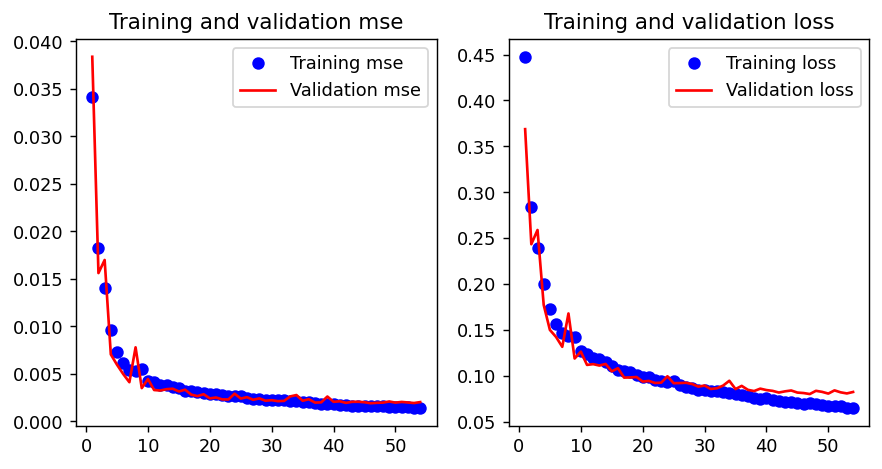

0.9342506253360124


In [6]:
%matplotlib inline
train_plot(hist)

# Naive calculation of score

naive = model.predict(CT)

z = []
for i in range(naive.shape[0]):
    z.append(ssim(TC[i,:,:,:],naive[i,:,:,:], gaussian_weights=True, multichannel=True, data_range=1))

naive_score= sum(z)/ len(z)

print(naive_score)


## Using the model
1. Load test dataset
2. Scale, create predictions, rescale
3. Save predictions
4. Create quick animation of the test and predicted datasets
* Note: This part could have some carpentery done, was made kinda in a rush


(199, 127, 127, 3)


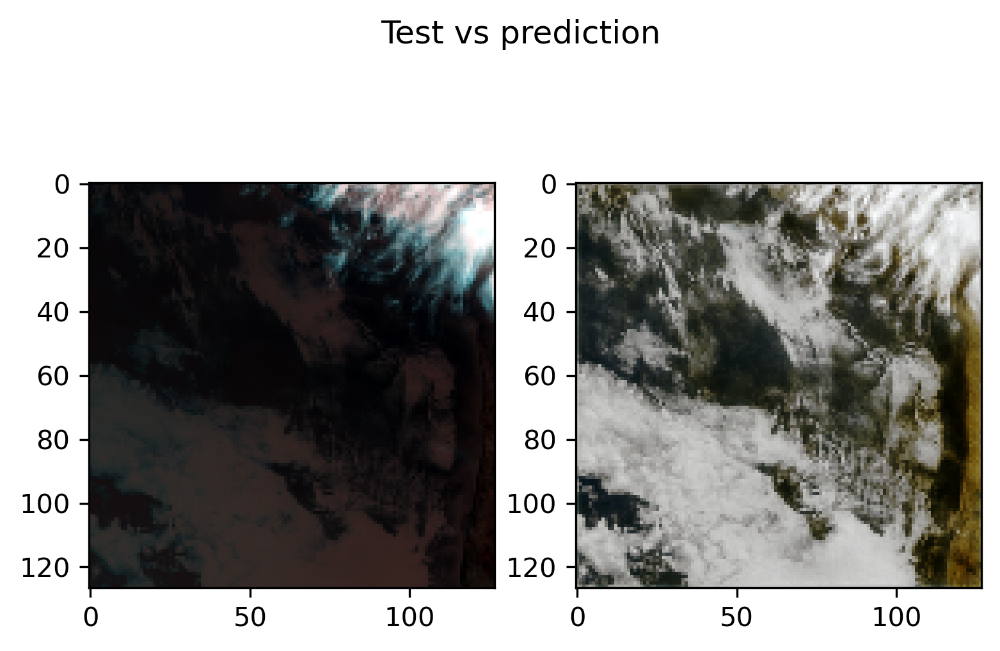

In [7]:
X_test = np.load("X_test_CI20_phase2.npy")

def pred_corr_save(X2pred = X_test, name= naive_score):
    X2pred_ = np.array(X2pred)
    for i in range(X2pred_.shape[0]):
        X2pred_[i,:,:,:] = X2pred_[i,:,:,:]/255

    predictions = model.predict(X2pred_)

    for i in range(predictions.shape[0]):
        predictions[i,:,:,:] = predictions[i,:,:,:]*255

    np.save('Y_test_CI20_phase2.predict_naive-{:0.4f}'.format(name), predictions)

    return predictions

pred = pred_corr_save()

# Create and save animation for fun

rc('animation', html='jshtml')
print(X_test.shape)

fig, axes = plt.subplots(1,2, dpi=300, figsize=(6,4))
fig.suptitle("Test vs prediction")
ims = []

for i in range(0,pred.shape[0],1):
    im1 = axes[0].imshow(array_to_img(X_test[i,:,:,:]), animated=True)
    im2 = axes[1].imshow(array_to_img(pred[i,:,:,:]), animated=True)
    ims.append([im1, im2])

ani = animation.ArtistAnimation(fig, ims, interval=100, blit=True)
ani.save("test_pred_naive-{:0.4f}.mp4".format(naive_score), dpi=300)

In [8]:
ani

Animation size has reached 21047938 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
